# Read Data

In [1]:
import pandas as pd

# Read the CSV file into a DataFrame
df = pd.read_csv('ATOM_USDT_futures_data_2020.csv')

# Display the first few rows of the DataFrame
df

,coin,opentime,openprice,highprice,lowprice,closeprice,volume,closetime,quotevolume,trades,taker_buy_volume,taker_buy_quote,unused
0,ATOM,1581076800000,4.574,4.870,4.573,4.610,78089.77,1581080399999,3.641201e+05,681,50177.14,2.347291e+05,0
1,ATOM,1581080400000,4.614,4.700,4.610,4.690,51144.09,1581083999999,2.381958e+05,819,28136.38,1.311441e+05,0
2,ATOM,1581084000000,4.685,4.870,4.658,4.839,141139.71,1581087599999,6.716110e+05,3167,83826.46,3.989023e+05,0
3,ATOM,1581087600000,4.838,4.895,4.775,4.886,232846.70,1581091199999,1.125742e+06,2313,71249.95,3.451195e+05,0
4,ATOM,1581091200000,4.874,4.909,4.782,4.815,139251.61,1581094799999,6.750462e+05,2486,61212.84,2.974051e+05,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
42553,ATOM,1734267600000,9.054,9.212,9.000,9.172,860635.63,1734271199999,7.846637e+06,33948,429163.43,3.913094e+06,0
42554,ATOM,1734271200000,9.173,9.308,9.172,9.233,907825.15,1734274799999,8.399720e+06,32356,446148.32,4.128727e+06,0
42555,ATOM,1734274800000,9.233,9.255,9.133,9.190,528154.00,1734278399999,4.856080e+06,21516,274433.03,2.523687e+06,0
42556,ATOM,1734278400000,9.190,9.223,9.068,9.088,802355.70,1734281999999,7.328597e+06,25741,371163.76,3.389462e+06,0


# Get OHLC

In [2]:
df_base = df[['opentime','openprice', 'highprice', 'lowprice', 'closeprice']]
df_base

,opentime,openprice,highprice,lowprice,closeprice
0,1581076800000,4.574,4.870,4.573,4.610
1,1581080400000,4.614,4.700,4.610,4.690
2,1581084000000,4.685,4.870,4.658,4.839
3,1581087600000,4.838,4.895,4.775,4.886
4,1581091200000,4.874,4.909,4.782,4.815
...,...,...,...,...,...
42553,1734267600000,9.054,9.212,9.000,9.172
42554,1734271200000,9.173,9.308,9.172,9.233
42555,1734274800000,9.233,9.255,9.133,9.190
42556,1734278400000,9.190,9.223,9.068,9.088


## Super Trend

In [35]:
import pandas as pd
import numpy as np

def calculate_supertrend(data, atr_period=10, factor=3.0):
    """
    Calculate Supertrend indicator.
    
    Parameters:
    - data: DataFrame with 'highprice', 'lowprice', and 'closeprice' columns.
    - atr_period: Period for Average True Range (ATR).
    - factor: Multiplier for the ATR to calculate the Supertrend.
    
    Returns:
    - DataFrame with Supertrend and trend direction ('Uptrend', 'Downtrend').
    """
    # Calculate ATR
    data['tr'] = np.maximum(data['highprice'] - data['lowprice'], 
                            np.maximum(np.abs(data['highprice'] - data['closeprice'].shift(1)), 
                                       np.abs(data['lowprice'] - data['closeprice'].shift(1))))
    data['atr'] = data['tr'].rolling(window=atr_period).mean()
    
    # Calculate Supertrend
    data['upper_band'] = (data['highprice'] + data['lowprice']) / 2 + factor * data['atr']
    data['lower_band'] = (data['highprice'] + data['lowprice']) / 2 - factor * data['atr']
    
    # Initialize Supertrend and direction
    data['supertrend'] = np.nan
    data['direction'] = 0
    
    for i in range(1, len(data)):
        if data['closeprice'][i] > data['upper_band'][i-1]:
            data['supertrend'][i] = data['lower_band'][i]
            data['direction'][i] = 1  # Uptrend
        elif data['closeprice'][i] < data['lower_band'][i-1]:
            data['supertrend'][i] = data['upper_band'][i]
            data['direction'][i] = -1  # Downtrend
        else:
            data['supertrend'][i] = data['supertrend'][i-1]
            data['direction'][i] = data['direction'][i-1]
    
    # Return the calculated supertrend
    return data

# Example usage
df_supertrend = calculate_supertrend(df_base)
df_supertrend = df_supertrend[['opentime','openprice','highprice', 'lowprice', 'closeprice', 'supertrend', 'direction']]
df_supertrend

/tmp/ipykernel_246951/1982848519.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['supertrend'][i] = data['supertrend'][i-1]
/tmp/ipykernel_246951/1982848519.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['direction'][i] = data['direction'][i-1]
/tmp/ipykernel_246951/1982848519.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['supertrend'][i] = data['supertrend'][i-1]
/tmp/ipykernel_246951/1982848519.py:39:

,opentime,openprice,highprice,lowprice,closeprice,supertrend,direction
0,2020-02-07 12:00:00,4.574,4.870,4.573,4.610,NaN,0
1,2020-02-07 13:00:00,4.614,4.700,4.610,4.690,NaN,0
2,2020-02-07 14:00:00,4.685,4.870,4.658,4.839,NaN,0
3,2020-02-07 15:00:00,4.838,4.895,4.775,4.886,NaN,0
4,2020-02-07 16:00:00,4.874,4.909,4.782,4.815,NaN,0
...,...,...,...,...,...,...,...
42553,2024-12-15 13:00:00,9.054,9.212,9.000,9.172,9.2033,-1
42554,2024-12-15 14:00:00,9.173,9.308,9.172,9.233,9.2033,-1
42555,2024-12-15 15:00:00,9.233,9.255,9.133,9.190,9.2033,-1
42556,2024-12-15 16:00:00,9.190,9.223,9.068,9.088,9.2033,-1


/tmp/ipykernel_246951/180248317.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_plot['opentime'] = pd.to_datetime(df_plot['opentime'])
/tmp/ipykernel_246951/180248317.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_plot.rename(columns={


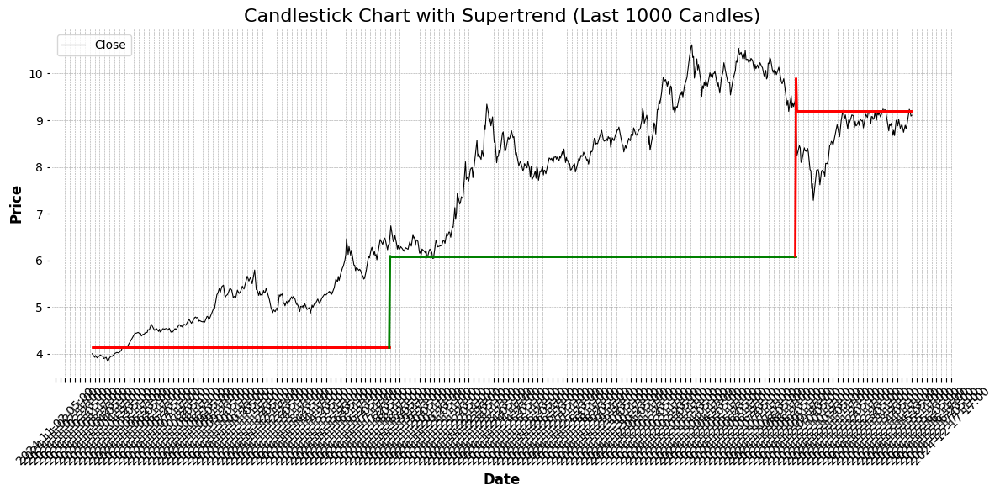

In [43]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd

# Function to plot last n candles and supertrend indicator
def plot_last_n_candles(df, n=50):
    """
    Plot the last n candles and the supertrend indicator.
    
    Parameters:
    - df: DataFrame with 'opentime', 'openprice', 'highprice', 'lowprice', 'closeprice', 'supertrend', 'direction'.
    - n: Number of latest rows (candles) to plot.
    """
    # Prepare the data for plotting
    df_plot = df.tail(n)  # Select only the last n rows

    # Ensure that 'opentime' is in datetime format and set it as index
    df_plot['opentime'] = pd.to_datetime(df_plot['opentime'])
    df_plot.set_index('opentime', inplace=True)

    # Rename the columns to match the format expected
    df_plot.rename(columns={
        'openprice': 'Open',
        'highprice': 'High',
        'lowprice': 'Low',
        'closeprice': 'Close',
    }, inplace=True)

    # Create a figure and axis for plotting
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot the candlestick chart using matplotlib
    ax.plot(df_plot.index, df_plot['Close'], label='Close', color='black', linewidth=0.8)

    # Loop through each row and plot the supertrend indicator
    for i in range(1, len(df_plot)):
        if df_plot['direction'].iloc[i] == 1:  # Uptrend
            ax.plot([df_plot.index[i-1], df_plot.index[i]], [df_plot['supertrend'].iloc[i-1], df_plot['supertrend'].iloc[i]], color='green', linewidth=2)
        elif df_plot['direction'].iloc[i] == -1:  # Downtrend
            ax.plot([df_plot.index[i-1], df_plot.index[i]], [df_plot['supertrend'].iloc[i-1], df_plot['supertrend'].iloc[i]], color='red', linewidth=2)

    # Format the x-axis to show dates properly
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
    ax.xaxis.set_major_locator(mdates.HourLocator(interval=6))  # Adjust the interval as needed
    plt.xticks(rotation=45)

    # Set title and labels
    ax.set_title(f'Candlestick Chart with Supertrend (Last {n} Candles)', fontsize=16)
    ax.set_xlabel('Date', fontsize=12)
    ax.set_ylabel('Price', fontsize=12)

    # Show the legend
    ax.legend(loc='upper left')

    # Display the plot
    plt.tight_layout()
    plt.show()

# Example usage:
n = 1000  # Customize the number of rows (candles) to plot
plot_last_n_candles(df_supertrend, n)

## Ichimoku Cloud

In [25]:
import pandas as pd

# Convert opentime to datetime (optional for better readability)
df_supertrend['opentime'] = pd.to_datetime(df_supertrend['opentime'], unit='ms')

def calculate_ichimoku(data, conversion_periods=9, base_periods=26, lagging_span2_periods=52, displacement=26):
    """
    Calculate the Ichimoku Cloud indicator.
    
    Parameters:
    - data: DataFrame with 'highprice', 'lowprice', and 'closeprice' columns.
    - conversion_periods: Period for Conversion Line (default 9).
    - base_periods: Period for Base Line (default 26).
    - lagging_span2_periods: Period for Leading Span B (default 52).
    - displacement: Period for shifting Leading Spans (default 26).
    
    Returns:
    - DataFrame with Ichimoku Cloud components.
    """
    # Conversion Line (Tenkan-sen)
    data['conversion_line'] = (data['highprice'].rolling(window=conversion_periods).max() +
                               data['lowprice'].rolling(window=conversion_periods).min()) / 2

    # Base Line (Kijun-sen)
    data['base_line'] = (data['highprice'].rolling(window=base_periods).max() +
                         data['lowprice'].rolling(window=base_periods).min()) / 2

    # Leading Span A (Senkou Span A)
    data['leading_span_a'] = ((data['conversion_line'] + data['base_line']) / 2).shift(displacement)

    # Leading Span B (Senkou Span B)
    data['leading_span_b'] = ((data['highprice'].rolling(window=lagging_span2_periods).max() +
                               data['lowprice'].rolling(window=lagging_span2_periods).min()) / 2).shift(displacement)

    # Lagging Span (Chikou Span)
    data['lagging_span'] = data['closeprice'].shift(-displacement)

    # Drop NaN values for cleaner results
    data = data.dropna()
    
    return data

# Apply the Ichimoku Cloud calculation
df_supertrend_ichimoku = calculate_ichimoku(df_supertrend)

# Display the first few rows of the resulting DataFrame
print(df_supertrend_ichimoku[['opentime', 'conversion_line', 'base_line', 'leading_span_a', 'leading_span_b', 'lagging_span']].head())

               opentime  conversion_line  base_line  leading_span_a  \
154 2020-02-13 22:00:00           4.9650      5.056         5.21950   
155 2020-02-13 23:00:00           4.9365      5.056         5.21650   
156 2020-02-14 00:00:00           4.9365      5.056         5.21650   
157 2020-02-14 01:00:00           4.8965      5.056         5.17825   
158 2020-02-14 02:00:00           4.8965      5.056         5.17825   

     leading_span_b  lagging_span  
154          5.0075         5.126  
155          5.0075         5.086  
156          5.0075         5.030  
157          5.0170         5.078  
158          5.0210         5.060  


/tmp/ipykernel_246951/954579301.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_supertrend['opentime'] = pd.to_datetime(df_supertrend['opentime'], unit='ms')
/tmp/ipykernel_246951/954579301.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['conversion_line'] = (data['highprice'].rolling(window=conversion_periods).max() +
/tmp/ipykernel_246951/954579301.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = v

In [26]:
df_supertrend_ichimoku

,opentime,openprice,highprice,lowprice,closeprice,conversion_line,base_line,leading_span_a,leading_span_b,lagging_span,high_low,high_close,low_close,tr,atr,upperband,lowerband,supertrend,direction,trend
154,2020-02-13 22:00:00,4.902,4.920,4.879,4.891,4.9650,5.0560,5.21950,5.0075,5.126,0.041,0.018,0.023,0.041,0.0948,5.1839,4.6151,4.2241,1,Neutral
155,2020-02-13 23:00:00,4.890,4.934,4.890,4.919,4.9365,5.0560,5.21650,5.0075,5.086,0.044,0.043,0.001,0.044,0.0826,5.1598,4.6642,4.2241,1,Neutral
156,2020-02-14 00:00:00,4.917,4.942,4.866,4.921,4.9365,5.0560,5.21650,5.0075,5.030,0.076,0.023,0.053,0.076,0.0707,5.1161,4.6919,4.2241,1,Neutral
157,2020-02-14 01:00:00,4.921,4.943,4.910,4.918,4.8965,5.0560,5.17825,5.0170,5.078,0.033,0.022,0.011,0.033,0.0645,5.1200,4.7330,4.2241,1,Neutral
158,2020-02-14 02:00:00,4.922,4.936,4.890,4.928,4.8965,5.0560,5.17825,5.0210,5.060,0.046,0.018,0.028,0.046,0.0538,5.0744,4.7516,4.2241,1,Neutral
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42501,2024-12-13 09:00:00,9.062,9.142,8.981,9.127,8.9380,8.9790,8.74400,8.2685,9.043,0.161,0.081,0.080,0.161,0.1836,9.6123,8.5107,3.4104,1,Uptrend
42502,2024-12-13 10:00:00,9.127,9.127,8.907,9.081,8.9455,8.9790,8.74400,8.2685,8.877,0.220,0.000,0.220,0.220,0.1894,9.5852,8.4488,3.4104,1,Uptrend
42503,2024-12-13 11:00:00,9.081,9.279,9.053,9.058,9.0140,9.0055,8.74400,8.2685,8.772,0.226,0.198,0.028,0.226,0.1870,9.7270,8.6050,3.4104,1,Uptrend
42504,2024-12-13 12:00:00,9.059,9.218,9.059,9.185,9.0140,9.0055,8.79200,8.2685,8.921,0.159,0.160,0.001,0.160,0.1766,9.6683,8.6087,3.4104,1,Uptrend


# Data Visualization

/tmp/ipykernel_246951/1641939324.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['opentime'] = pd.to_datetime(df['opentime'], unit='ms')
/tmp/ipykernel_246951/1641939324.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['date_num'] = mdates.date2num(df['opentime'])


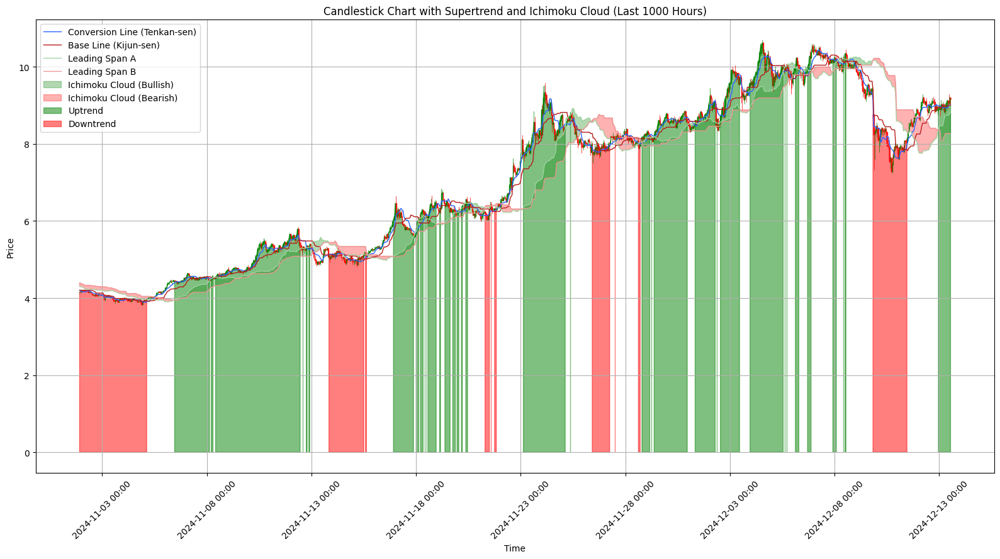

In [28]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd
from mplfinance.original_flavor import candlestick_ohlc
import matplotlib.ticker as mticker
import matplotlib.patches as mpatches

# Function to plot the data
def plot_supertrend_ichimoku(df, n):
    # Filter the last n hours
    df = df.iloc[-n:]

    # Convert 'opentime' to matplotlib date format for plotting
    df['opentime'] = pd.to_datetime(df['opentime'], unit='ms')
    df['date_num'] = mdates.date2num(df['opentime'])

    # Create the figure and axis
    fig, ax = plt.subplots(figsize=(16, 9))

    # Plot the candlestick chart
    ohlc = df[['date_num', 'openprice', 'highprice', 'lowprice', 'closeprice']].values
    candlestick_ohlc(ax, ohlc, width=0.02, colorup='green', colordown='red', alpha=0.8)

    # Plot Ichimoku Cloud
    ax.plot(df['date_num'], df['conversion_line'], label='Conversion Line (Tenkan-sen)', color='#2962FF', linewidth=1)
    ax.plot(df['date_num'], df['base_line'], label='Base Line (Kijun-sen)', color='#B71C1C', linewidth=1)
    ax.plot(df['date_num'], df['leading_span_a'], label='Leading Span A', color='#A5D6A7', linewidth=1)
    ax.plot(df['date_num'], df['leading_span_b'], label='Leading Span B', color='#EF9A9A', linewidth=1)
    
    # Fill Ichimoku Cloud
    ax.fill_between(
        df['date_num'],
        df['leading_span_a'],
        df['leading_span_b'],
        where=(df['leading_span_a'] > df['leading_span_b']),
        color='green',
        alpha=0.3,
        label='Ichimoku Cloud (Bullish)'
    )
    ax.fill_between(
        df['date_num'],
        df['leading_span_a'],
        df['leading_span_b'],
        where=(df['leading_span_a'] <= df['leading_span_b']),
        color='red',
        alpha=0.3,
        label='Ichimoku Cloud (Bearish)'
    )

    # Trend identification (Uptrend or Downtrend)
    ax.fill_between(
        df['date_num'],
        df['closeprice'],
        where=(df['trend'] == 'Uptrend'),
        color='green',
        alpha=0.5,
        label='Uptrend'
    )
    ax.fill_between(
        df['date_num'],
        df['closeprice'],
        where=(df['trend'] == 'Downtrend'),
        color='red',
        alpha=0.5,
        label='Downtrend'
    )

    # Format the x-axis
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
    ax.xaxis.set_major_locator(mticker.MaxNLocator(10))
    plt.xticks(rotation=45)

    # Add legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles, labels, loc='upper left')

    # Set labels and title
    ax.set_xlabel('Time')
    ax.set_ylabel('Price')
    ax.set_title(f'Candlestick Chart with Supertrend and Ichimoku Cloud (Last {n} Hours)')

    # Show grid
    ax.grid(True)

    # Show the plot
    plt.tight_layout()
    plt.show()

# Example usage
# Assuming df_supertrend_ichimoku is already loaded
plot_supertrend_ichimoku(df_supertrend_ichimoku, n=1000)